In [6]:
from subprocess import check_output
from google.colab import drive
drive.mount('/content/gdrive')
print(check_output(["ls", "../content/gdrive/My Drive/Colab Notebooks/Project 1 | Computer Vision with CNN/"]).decode("utf8"))

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive
Project_1_Computer_Vision_With_CNN.ipynb
test
train



In [0]:
import os, sys
from IPython.display import display
from IPython.display import Image as _Imgdis
from PIL import Image
import numpy as np
from time import time
from time import sleep
from random import shuffle
import cv2
import tensorflow as tf
import keras
import glob

In [0]:
def load_images_from_folder(folder):
    images = []
    for filename in os.listdir(folder):
            images.append(filename)
    return images

In [0]:
IMG_SIZE = 64
train_folder = "../content/gdrive/My Drive/Colab Notebooks/Project 1 | Computer Vision with CNN/train/" 
test_folder = "../content/gdrive/My Drive/Colab Notebooks/Project 1 | Computer Vision with CNN/test"

train_files_array = [f for f in os.listdir(train_folder) if os.path.isdir(os.path.join(train_folder, f))]
                
train_files = {};

for i in range(0, len(train_files_array) - 1):
    image_set = {train_files_array[i] : load_images_from_folder(os.path.join(train_folder, train_files_array[i]))}
    train_files.update(image_set)
    
test_files = load_images_from_folder(test_folder)

Train Image examples: 
Image Set Scentless Mayweed : Number of Images: 516


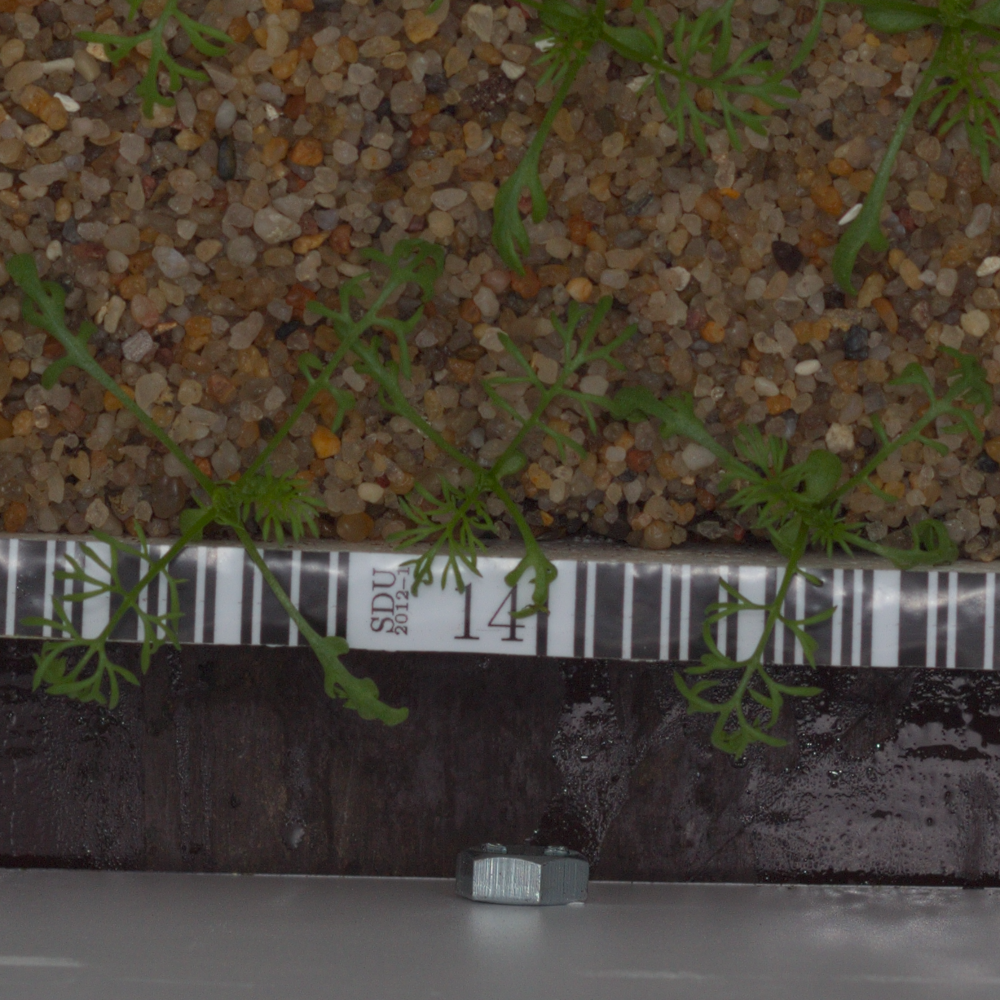

Image Set Sugar beet : Number of Images: 385


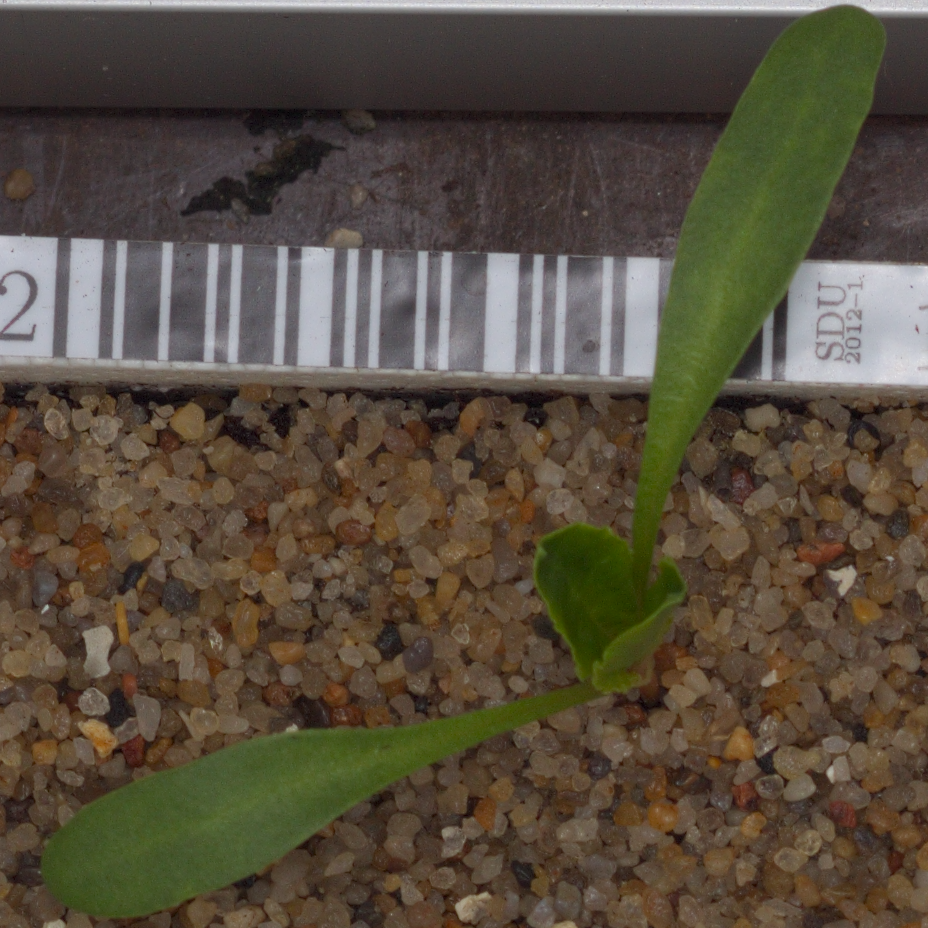

Image Set Common wheat : Number of Images: 221


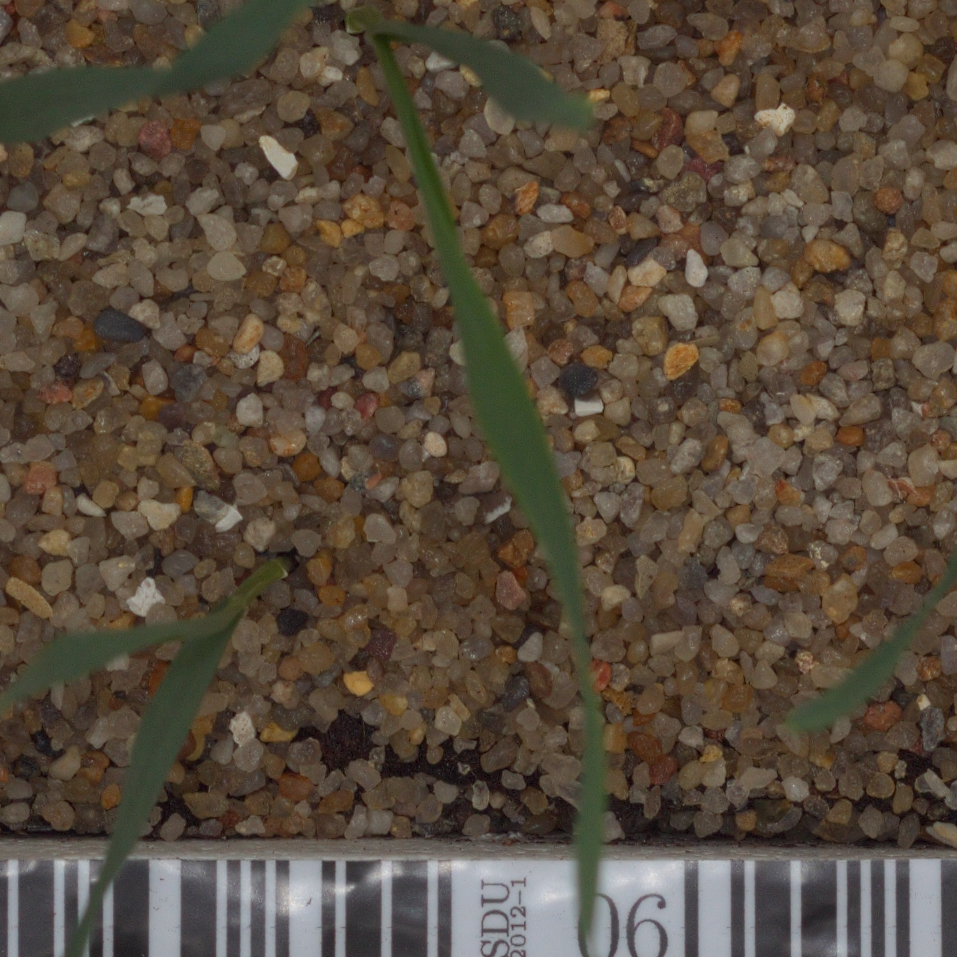

Image Set Loose Silky-bent : Number of Images: 654


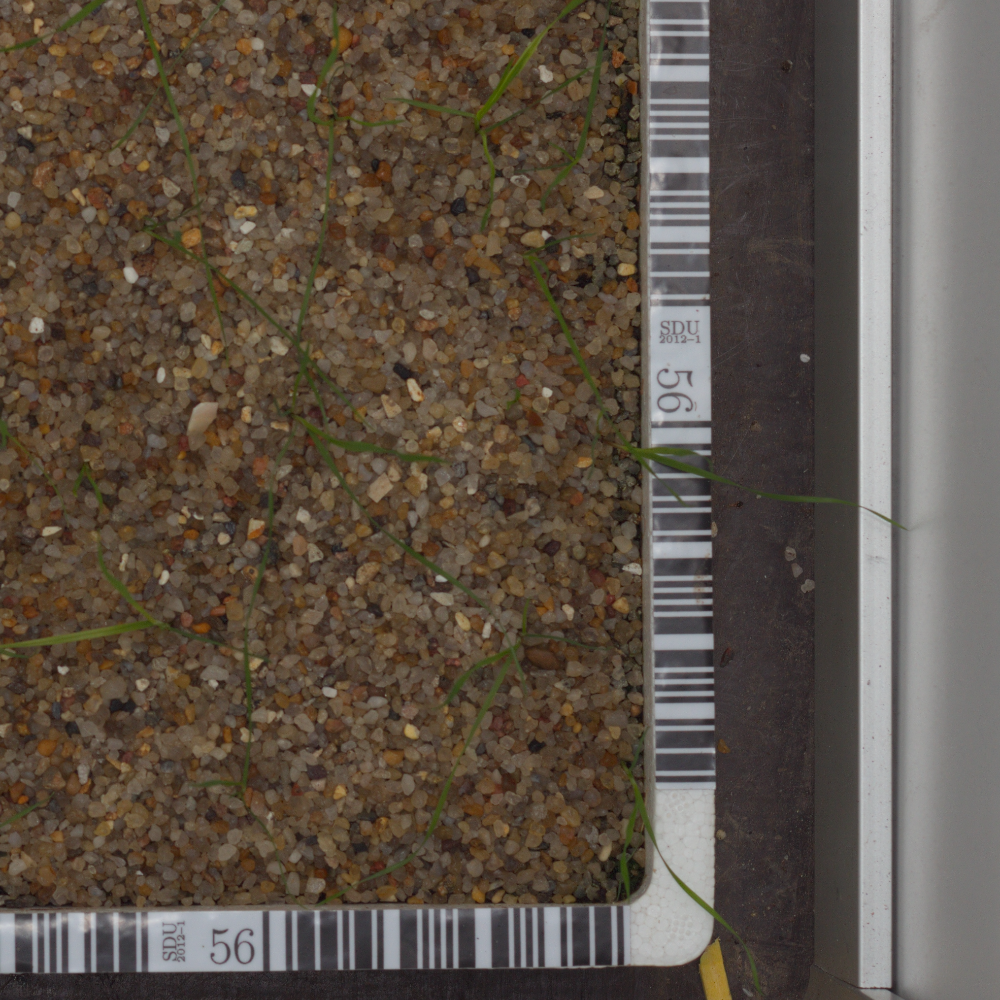

Image Set Common Chickweed : Number of Images: 611


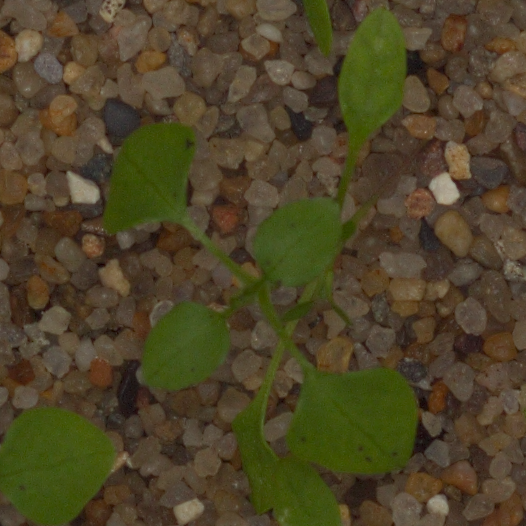

Image Set Black-grass : Number of Images: 263


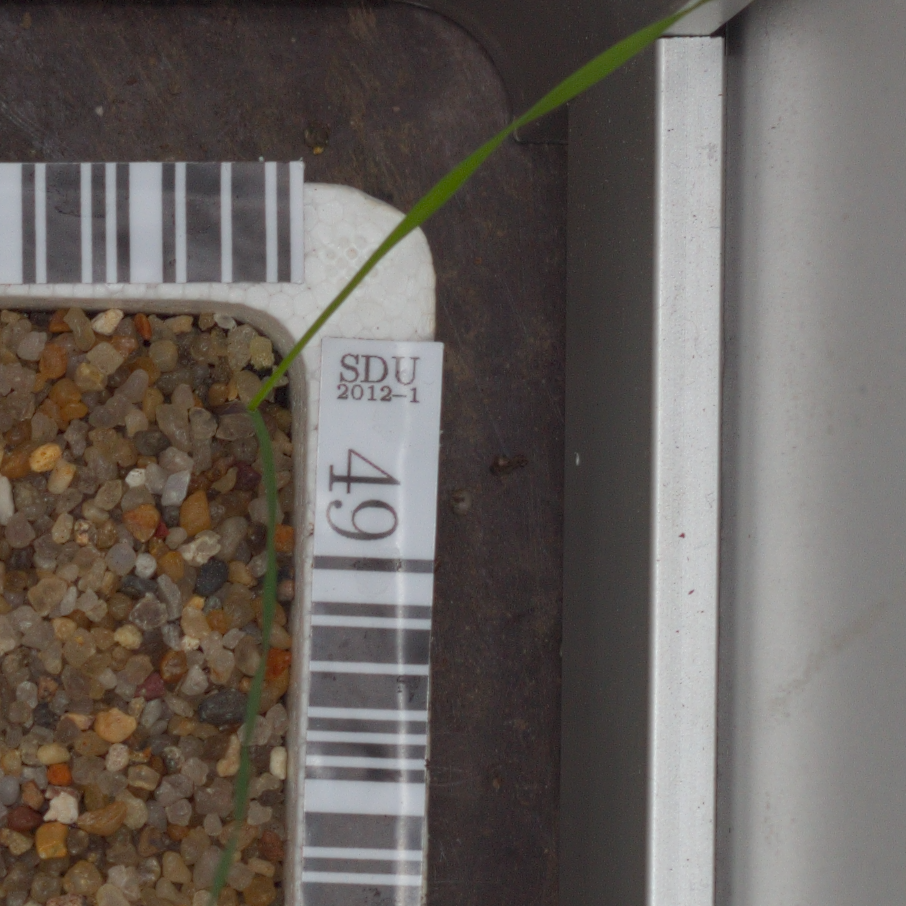

Image Set Cleavers : Number of Images: 287


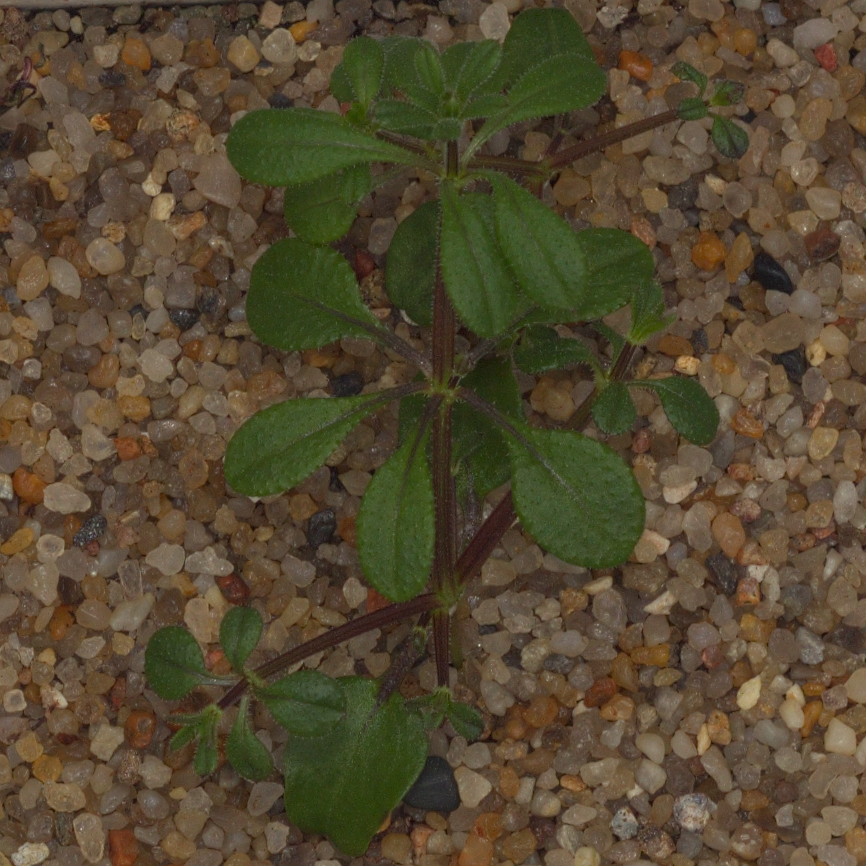

Image Set Small-flowered Cranesbill : Number of Images: 496


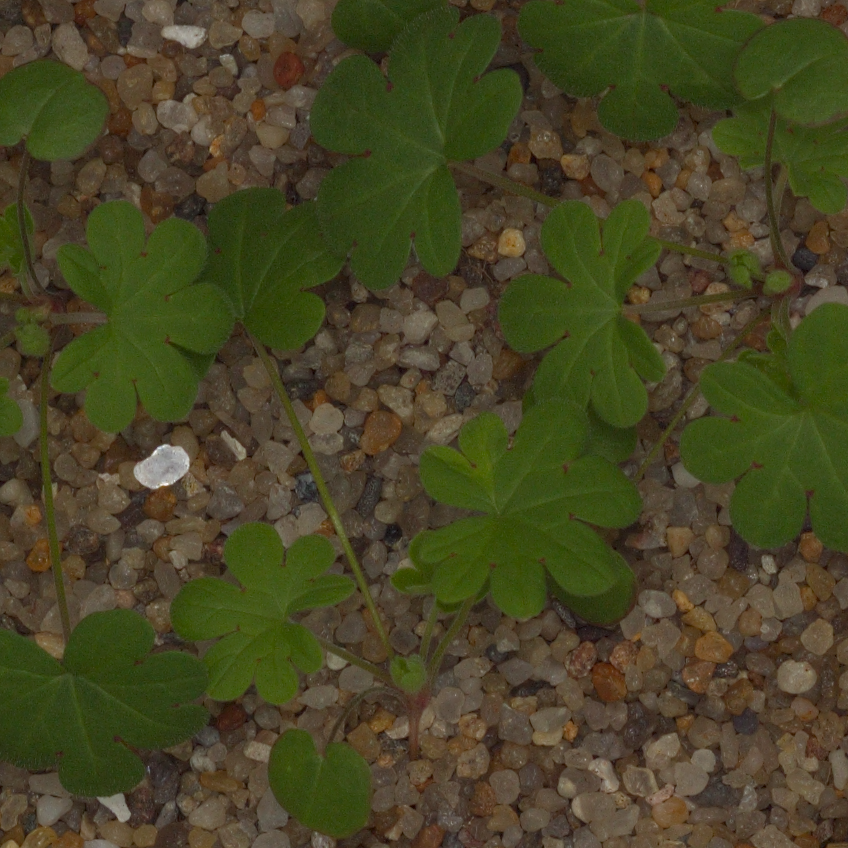

Image Set Fat Hen : Number of Images: 475


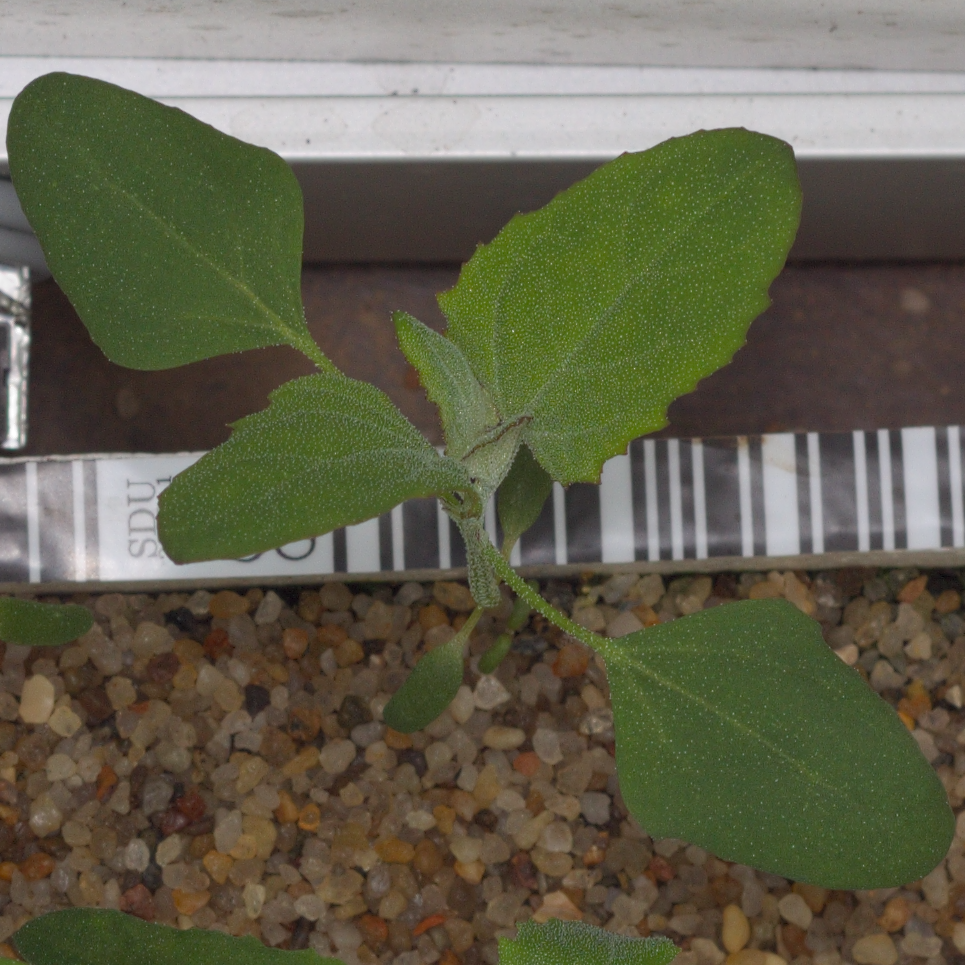

Image Set Shepherds Purse : Number of Images: 241


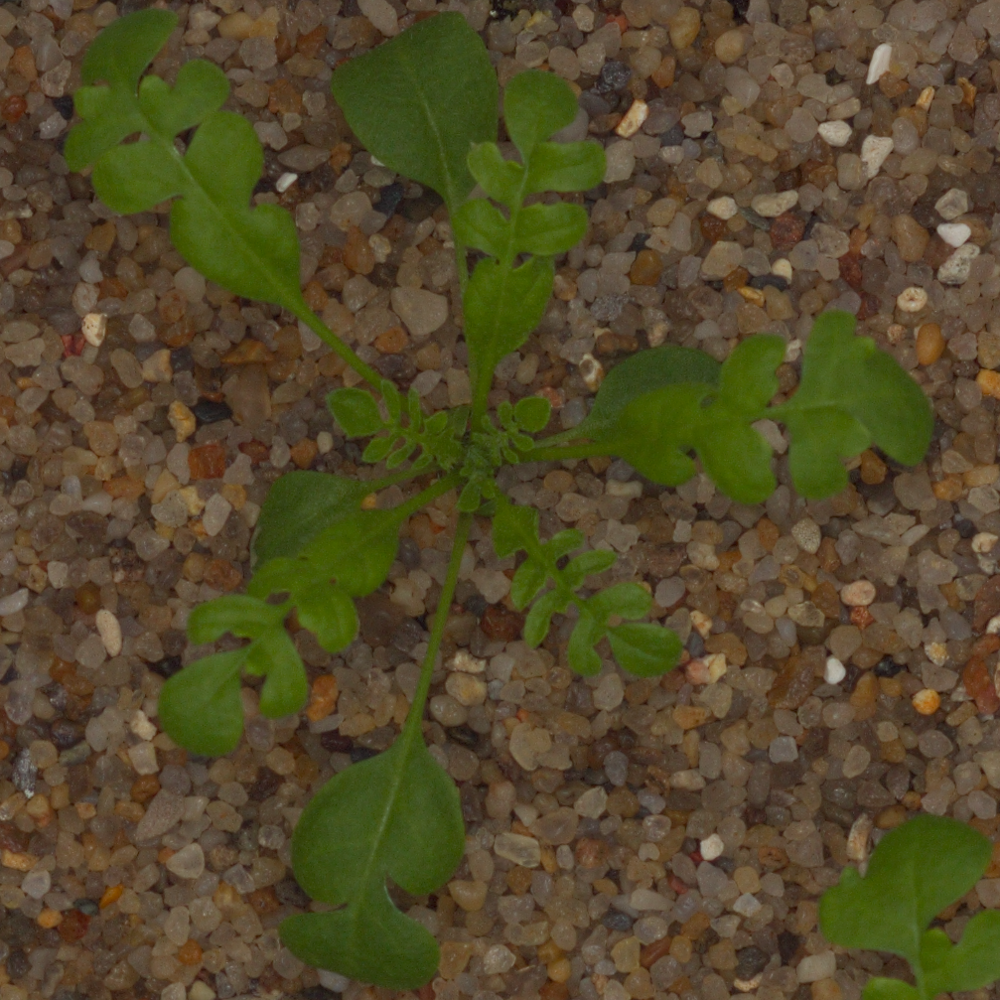

Image Set Maize : Number of Images: 221


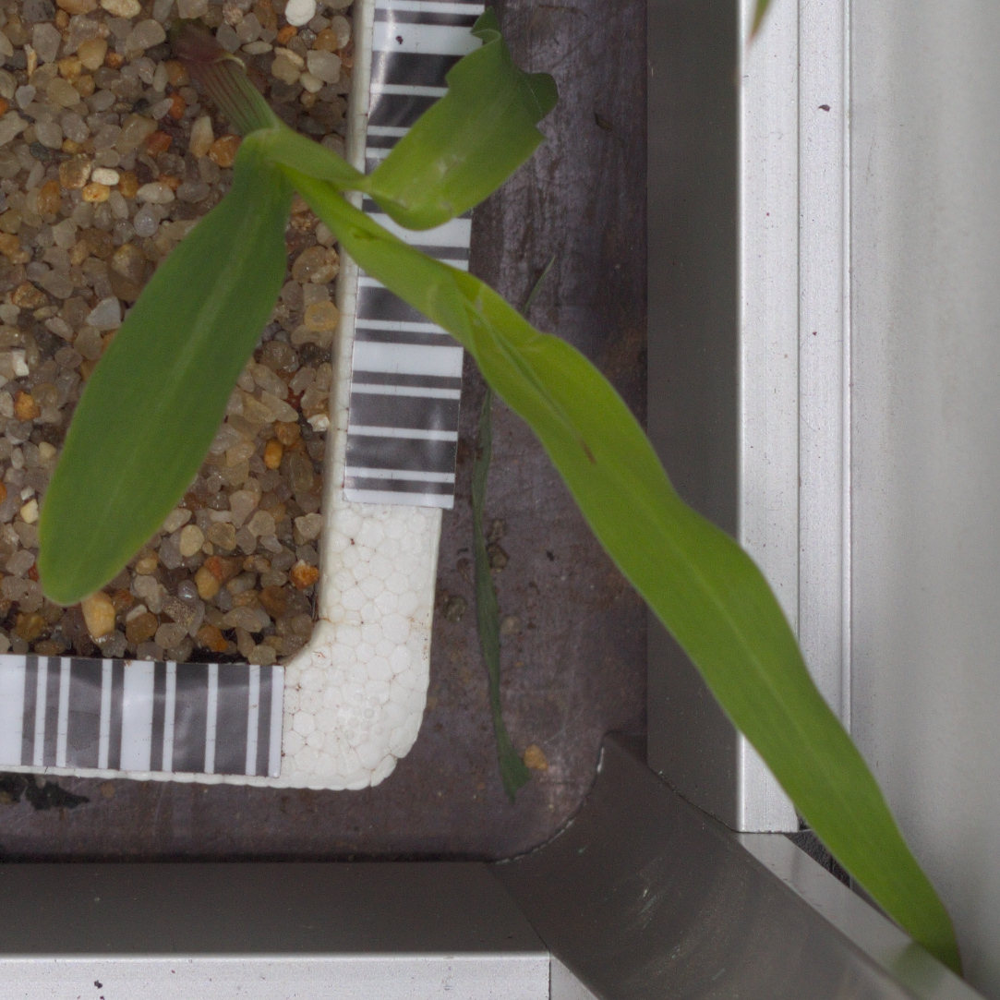

Working with 794 Test images
Test Image Example: 


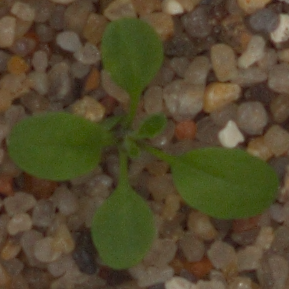

In [56]:
print("Train Image examples: ")
for image_set, content in train_files.items():
    print("Image Set", image_set, ": Number of Images:", len(content))
    display(_Imgdis(filename=train_folder + "/" + image_set + "/" + content[0], width=240, height=320))
    
print("Working with {0} Test images".format(len(test_files)))

print("Test Image Example: ")
display(_Imgdis(filename=test_folder + "/" + test_files[0], width=240, height=320))

## POC for Retrieving Data

In [0]:
#Abandoning this cell, only a proof of concept, kindly ignore
def label_img(word_label):                       
    if word_label == 'Black-grass': return [1,0,0,0,0,0,0,0,0,0,0,0]
    elif word_label == 'Charlock': return [0,1,0,0,0,0,0,0,0,0,0,0]
    elif word_label == 'Cleavers': return [0,0,1,0,0,0,0,0,0,0,0,0]
    elif word_label == 'Common Chickweed': return [0,0,0,1,0,0,0,0,0,0,0,0]
    elif word_label == 'Common wheat': return [0,0,0,0,1,0,0,0,0,0,0,0]
    elif word_label == 'Fat Hen': return [0,0,0,0,0,1,0,0,0,0,0,0]
    elif word_label == 'Loose Silky-bent': return [0,0,0,0,0,0,1,0,0,0,0,0]
    elif word_label == 'Maize': return [0,0,0,0,0,0,0,1,0,0,0,0]
    elif word_label == 'Scentless Mayweed': return [0,0,0,0,0,0,0,0,1,0,0,0]
    elif word_label == 'Shepherds Purse': return [0,0,0,0,0,0,0,0,0,1,0,0]
    elif word_label == 'Small-flowered Cranesbill': return [0,0,0,0,0,0,0,0,0,0,1,0]
    elif word_label == 'Sugar beet': return [0,0,0,0,0,0,0,0,0,0,0,1]

In [0]:
#Abandoning this cell, only a proof of concept, kindly ignore
def create_train_data():
    train = []
    for image_set, content in train_files.items():
        for img in content:
            label=label_img(image_set)
            path=os.path.join(train_folder,image_set,img)
            img=cv2.imread(path,cv2.IMREAD_GRAYSCALE)
            img = cv2.resize(img, (IMG_SIZE,IMG_SIZE))
            train.append([np.array(img),np.array(label)])
    shuffle(train)
    return train

In [0]:
#Abandoning this cell, only a proof of concept, kindly ignore
def create_test_data():
    test = []
    for img in test_files:
        path = os.path.join(test_folder,img)
        img_num = img
        img = cv2.imread(path,cv2.IMREAD_GRAYSCALE)
        img = cv2.resize(img, (IMG_SIZE,IMG_SIZE))
        test.append([np.array(img), img_num]) 
    shuffle(test)
    return test

In [0]:
#train_data = create_train_data()
#test_data = create_test_data()

In [0]:
#Abandoning this cell, only a proof of concept, kindly ignore
X_train = np.array([i[0] for i in train_data]).reshape(-1,IMG_SIZE,IMG_SIZE,1)
Y_train = [i[1] for i in train_data]

x_test = np.array([i[0] for i in test_data]).reshape(-1,IMG_SIZE,IMG_SIZE,1)
y_test = [i[1] for i in test_data]

In [0]:
#Abandoning this cell, only a proof of concept, kindly ignore
test_data[0][0][1][4]

66

## Kindly ignore above POC, working code starts below

In [0]:
#Referenced from Kaggle Kernel
def load_train(path,plants,size):
    images=[]
    labels=[]
    ids=[]
    clas=[]
    for fold in plants:
        print("Fold: ", fold)
        index=plants.index(fold)
        pat = os.path.join(path, fold)
        files = glob.glob(pat+'/*')
        for f1 in files:
            im=cv2.imread(f1)
            image = cv2.resize(im, (size, size), cv2.INTER_LINEAR)
            images.append(image)
            label = np.zeros(len(plants))
            label[index] = 1.0
            labels.append(label)
    images = np.array(images)
    labels = np.array(labels)
    images = images.astype(np.float32)
    images = np.multiply(images, 1.0 / 255.0)
    return images,labels

In [102]:
print("Image Size: ", IMG_SIZE)
X, Y = load_train(train_folder, train_files_array, IMG_SIZE)

Image Size:  64
Fold:  Scentless Mayweed
Fold:  Sugar beet
Fold:  Common wheat
Fold:  Loose Silky-bent
Fold:  Common Chickweed
Fold:  Black-grass
Fold:  Cleavers
Fold:  Small-flowered Cranesbill
Fold:  Fat Hen
Fold:  Shepherds Purse
Fold:  Maize
Fold:  Charlock


In [103]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(X, Y, test_size=0.25, random_state = 7, shuffle = True)
print(x_train.shape,x_test.shape, y_train.shape, y_test.shape)

(3570, 64, 64, 3) (1190, 64, 64, 3) (3570, 12) (1190, 12)


In [0]:
#Normalization
x_train_conv =  x_train.astype("float32") / 255
x_test_conv = x_test.astype("float32") / 255

In [0]:
x_train_conv = x_train_conv.reshape(x_train_conv.shape[0], IMG_SIZE, IMG_SIZE, 3)
x_test_conv = x_test_conv.reshape(x_test_conv.shape[0], IMG_SIZE, IMG_SIZE, 3)

In [107]:
print(x_train_conv.shape)
print(x_test_conv.shape)

(3570, 64, 64, 3)
(1190, 64, 64, 3)


In [0]:
#Subsample the data for more efficient code execution in this exercise
num_training =  1200
mask = range(num_training)
X_train = x_train_conv[mask]
trainY = y_train[mask]

num_test = 400
mask = range(num_test)
X_test = x_test_conv[mask]
testY = y_test[mask]

In [0]:
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Activation, Flatten, Dense, Dropout
from keras import backend as K
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import EarlyStopping, ModelCheckpoint

In [0]:
#Attempting to use Data Augmentation
datagen = ImageDataGenerator(
    featurewise_center=False,  
    samplewise_center=False,  
    featurewise_std_normalization=False,  
    samplewise_std_normalization=False,  
    rotation_range=25,  
    width_shift_range=0.1,  
    height_shift_range=0.1,  
    horizontal_flip=False,  
    vertical_flip=False)  

In [0]:
# Set up the generator
datagen.fit(x_train_conv)
callback = [EarlyStopping(monitor='val_loss', patience = 5)]

In [0]:
model_data_augment = Sequential()

model_data_augment.add(Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=(IMG_SIZE,IMG_SIZE,3)))
model_data_augment.add(MaxPooling2D(pool_size=(2, 2)))
model_data_augment.add(Conv2D(64, kernel_size=(3, 3), activation='relu'))
model_data_augment.add(MaxPooling2D(pool_size=(2, 2)))
model_data_augment.add(Dropout(0.25))
model_data_augment.add(Conv2D(128, kernel_size=(3, 3), activation='relu'))
model_data_augment.add(Dropout(0.25))
model_data_augment.add(Flatten())
model_data_augment.add(Dense(128, activation='relu'))
model_data_augment.add(Dropout(0.25))
model_data_augment.add(Dense(12, activation='softmax'))

In [113]:
model_data_augment.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_22 (Conv2D)           (None, 62, 62, 32)        896       
_________________________________________________________________
max_pooling2d_15 (MaxPooling (None, 31, 31, 32)        0         
_________________________________________________________________
conv2d_23 (Conv2D)           (None, 29, 29, 64)        18496     
_________________________________________________________________
max_pooling2d_16 (MaxPooling (None, 14, 14, 64)        0         
_________________________________________________________________
dropout_16 (Dropout)         (None, 14, 14, 64)        0         
_________________________________________________________________
conv2d_24 (Conv2D)           (None, 12, 12, 128)       73856     
_________________________________________________________________
dropout_17 (Dropout)         (None, 12, 12, 128)       0         
__________

In [0]:
model_data_augment.compile(loss='categorical_crossentropy', optimizer="adam", metrics=['accuracy'])

In [115]:
history = model_data_augment.fit_generator(datagen.flow(x_train_conv, y_train, batch_size = 512), 
                validation_data = (x_test_conv, y_test), steps_per_epoch=len(x_train_conv) / 32 , use_multiprocessing = True, epochs=5, callbacks = callback)

Epoch 1/5
112/111 [==============================] - 57s 511ms/step - loss: 2.4233 - acc: 0.1350 - val_loss: 2.4184 - val_acc: 0.1395
Epoch 2/5
112/111 [==============================] - 57s 512ms/step - loss: 2.4153 - acc: 0.1406 - val_loss: 2.3713 - val_acc: 0.1815
Epoch 3/5
112/111 [==============================] - 57s 510ms/step - loss: 2.2630 - acc: 0.2123 - val_loss: 2.1174 - val_acc: 0.2529
Epoch 4/5
112/111 [==============================] - 57s 510ms/step - loss: 1.9196 - acc: 0.3286 - val_loss: 1.6412 - val_acc: 0.4218
Epoch 5/5
112/111 [==============================] - 56s 499ms/step - loss: 1.6678 - acc: 0.4162 - val_loss: 1.4694 - val_acc: 0.4857


In [116]:
model_data_augment.evaluate(x_test_conv, y_test)

1190/1190 [==============================] - 0s 170us/step


[1.469407908054961, 0.4857142857142857]

In [0]:
#Average accuracy, Lets now try a rather simple model

In [0]:
model_simple_conv = Sequential()

model_simple_conv.add(Conv2D(32, kernel_size = (3, 3), activation = "relu", input_shape=(IMG_SIZE, IMG_SIZE, 3)))
model_simple_conv.add(Conv2D(32, kernel_size = (3, 3), activation = "relu", input_shape=(IMG_SIZE, IMG_SIZE, 3)))
model_simple_conv.add(Flatten())
model_simple_conv.add(Dense(128, activation='relu'))
model_simple_conv.add(Dense(12, activation='softmax'))

model_simple_conv.compile(loss='categorical_crossentropy', optimizer="adam", metrics=['accuracy'])

In [120]:
output_simple_conv = model_simple_conv.fit(x_train_conv, y_train, callbacks = callback, batch_size = 512,
                                           epochs = 10, verbose = 1, validation_data = (x_test_conv, y_test))

Train on 3570 samples, validate on 1190 samples
Epoch 1/10
3570/3570 [==============================] - 3s 916us/step - loss: 2.4538 - acc: 0.1244 - val_loss: 2.4294 - val_acc: 0.1042
Epoch 2/10
3570/3570 [==============================] - 1s 222us/step - loss: 2.4291 - acc: 0.1165 - val_loss: 2.4290 - val_acc: 0.1101
Epoch 3/10
3570/3570 [==============================] - 1s 222us/step - loss: 2.4190 - acc: 0.1300 - val_loss: 2.4195 - val_acc: 0.1395
Epoch 4/10
3570/3570 [==============================] - 1s 222us/step - loss: 2.4181 - acc: 0.1367 - val_loss: 2.4199 - val_acc: 0.1395
Epoch 5/10
3570/3570 [==============================] - 1s 224us/step - loss: 2.4188 - acc: 0.1367 - val_loss: 2.4193 - val_acc: 0.1395
Epoch 6/10
3570/3570 [==============================] - 1s 222us/step - loss: 2.4185 - acc: 0.1353 - val_loss: 2.4248 - val_acc: 0.1101
Epoch 7/10
3570/3570 [==============================] - 1s 221us/step - loss: 2.4178 - acc: 0.1361 - val_loss: 2.4229 - val_acc: 0.1395


In [121]:
model_simple_conv.evaluate(x_test_conv, y_test)

1190/1190 [==============================] - 0s 167us/step


[2.421529750663693, 0.11008403363848934]

In [0]:
#A rather poor model. Lets try with pooling and without Data Augmentation

In [0]:
model_pooling_conv = Sequential()

model_pooling_conv.add(Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=(IMG_SIZE,IMG_SIZE,3)))
model_pooling_conv.add(MaxPooling2D(pool_size=(2, 2)))
model_pooling_conv.add(Conv2D(64, (3, 3), activation='relu'))
model_pooling_conv.add(MaxPooling2D(pool_size=(2, 2)))
model_pooling_conv.add(Dropout(0.25))
model_pooling_conv.add(Flatten())
model_pooling_conv.add(Dense(128, activation='relu'))
model_pooling_conv.add(Dense(12, activation='softmax'))

model_pooling_conv.compile(loss='categorical_crossentropy', optimizer="adam", metrics=['accuracy'])

In [124]:
model_pooling_conv.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_27 (Conv2D)           (None, 62, 62, 32)        896       
_________________________________________________________________
max_pooling2d_17 (MaxPooling (None, 31, 31, 32)        0         
_________________________________________________________________
conv2d_28 (Conv2D)           (None, 29, 29, 64)        18496     
_________________________________________________________________
max_pooling2d_18 (MaxPooling (None, 14, 14, 64)        0         
_________________________________________________________________
dropout_19 (Dropout)         (None, 14, 14, 64)        0         
_________________________________________________________________
flatten_12 (Flatten)         (None, 12544)             0         
_________________________________________________________________
dense_23 (Dense)             (None, 128)               1605760   
__________

In [125]:
output_pooling_conv = model_pooling_conv.fit(x_train_conv, y_train, callbacks = callback, batch_size = 512, 
                                             epochs = 10, verbose=1, validation_data=(x_test_conv, y_test))
                

Train on 3570 samples, validate on 1190 samples
Epoch 1/10
3570/3570 [==============================] - 1s 382us/step - loss: 2.4582 - acc: 0.1305 - val_loss: 2.4435 - val_acc: 0.1101
Epoch 2/10
3570/3570 [==============================] - 1s 141us/step - loss: 2.4254 - acc: 0.1356 - val_loss: 2.4192 - val_acc: 0.1395
Epoch 3/10
3570/3570 [==============================] - 1s 141us/step - loss: 2.4194 - acc: 0.1331 - val_loss: 2.4212 - val_acc: 0.1101
Epoch 4/10
3570/3570 [==============================] - 0s 139us/step - loss: 2.4190 - acc: 0.1356 - val_loss: 2.4225 - val_acc: 0.1395
Epoch 5/10
3570/3570 [==============================] - 1s 141us/step - loss: 2.4184 - acc: 0.1322 - val_loss: 2.4212 - val_acc: 0.1101
Epoch 6/10
3570/3570 [==============================] - 1s 140us/step - loss: 2.4172 - acc: 0.1322 - val_loss: 2.4189 - val_acc: 0.1395
Epoch 7/10
3570/3570 [==============================] - 0s 140us/step - loss: 2.4170 - acc: 0.1367 - val_loss: 2.4189 - val_acc: 0.1395


In [0]:
#Again a very poor accuracy, the model with data augmented seemed the best in this case, so lets evaluate it further

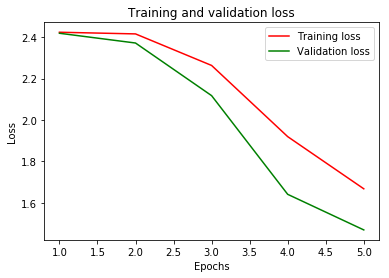

In [127]:
import matplotlib.pyplot as plt

loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt.plot(epochs, loss, color='red', label='Training loss')
plt.plot(epochs, val_loss, color='green', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

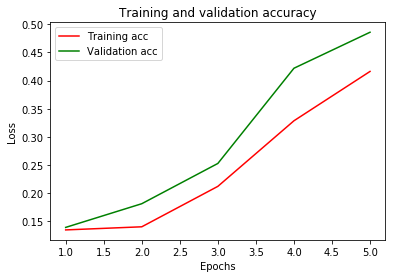

In [128]:
acc = history.history['acc']
val_acc = history.history['val_acc']
plt.plot(epochs, acc, color='red', label='Training acc')
plt.plot(epochs, val_acc, color='green', label='Validation acc')
plt.title('Training and validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [0]:
#So it seems model has performed better and with lesser loss drastically on the 3rd epoch, for the data augmentation case

In [130]:
data_augment_conv_score = model_data_augment.evaluate(x_test_conv, y_test)
print('Data Augmented Convolution Test loss:', data_augment_conv_score[0])
print('Data Augmented Convolution Test accuracy:', data_augment_conv_score[1])

1190/1190 [==============================] - 0s 140us/step
Data Augmented Convolution Test loss: 1.469407908054961
Data Augmented Convolution Test accuracy: 0.4857142857142857


Overall, this was a complex task due to image resolution being quite high originally and data augmented model provided much better accuracy than the pooling and simple CNN models.

I believe the accuracy can be improved maybe by further finetuning the hyperparameters (number of epochs, optimizer configuration and batch size) for the data augmentation case, though there is the computational complexity drawback inherent in data augmentation cases.

Note that I had eatlier attempted to use 32 * 32 size resolution, which provided awful results so I increased the size to 64 * 64. Also the dataset is quite large, hence preprocessing deeply could have helped improve model accuracy further. Earlier resolution of 128 by 128 was computationally difficult with current Colab GPU Environment, and may have provided better results.